# Clasificador de Grietas mediante Red Neuronal Convolutiva (CNN)

### Trabajo elaborado por:
**Daniel Francisco Calderón Lebrón**  
Estudiante de Ingeniería en Automatización y control, 2024-2  
Politécnico Colombiano Jaime Isaza Cadavid  

---

## Descripción del Proyecto

Este proyecto tiene como objetivo el desarrollo de un clasificador de grietas en concreto utilizando una Red Neuronal Convolutiva (CNN). Las imágenes de concreto son procesadas por la red neuronal para determinar si contienen grietas o no. Este sistema es fundamental en la inspección automatizada de infraestructuras, proporcionando una herramienta eficiente para detectar daños estructurales.

### Tecnologías Utilizadas:
- **TensorFlow**: Para la creación y entrenamiento de la red neuronal convolutiva.
- **OpenCV**: Para el procesamiento de imágenes.
- **Python**: Lenguaje de programación principal.
- **Keras**: Framework para construir redes neuronales.

---

## Objetivos
- Desarrollar un modelo de red neuronal convolutiva capaz de detectar grietas en imágenes de concreto.
- Evaluar la precisión del modelo mediante métricas como la precisión, recall, F1-score y la matriz de confusión.
- Implementar el sistema para clasificación binaria (con grieta / sin grieta) con alto rendimiento y precisión.

---

## Resultados Esperados
- Un clasificador entrenado con imágenes de grietas en concreto que sea capaz de identificar correctamente las grietas en nuevas imágenes.
- Mejoras en la detección de daños estructurales para su implementación en proyectos de inspección automatizada.

---

## Contacto
- **Email**: daniel_calderon91151@elpoli.edu.co  
- **GitHub**: [@Daniel-Francisco-Calderon-Lebro](https://github.com/Daniel-Francisco-Calderon-Lebro/Vision_por_Computador_con_IA)


### Librerias Implementadas

In [1]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Activation
from tensorflow.keras.optimizers import RMSprop,Adam
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.keras.utils import plot_model
import pickle
import numpy as np
import cv2
import os
import random
import matplotlib.pyplot as plt


### Especificación de las carpetas

In [2]:
base_path = r'C:\Users\Daniel Calderon\Desktop\2024-2 Poli\Vision Con IA\Practica5_(ParcialFinal)\Base_datos'
folder = 'Grietas_NoGrietas'
sub_folders = ['Con_Grietas', 'Sin_Grietas']

### Adquisión de Datos

In [3]:
data = []
labels = []
for subfolder in sub_folders:
    files = [f for f in os.listdir(base_path + '/' + folder + '/' + subfolder) if f.endswith('.jpg')]
    for file in files:
        img = cv2.imread(base_path + '/' + folder + '/' + subfolder + '/' + file, cv2.IMREAD_COLOR)
        img = cv2.resize(img, (128, 128))
        img = img.astype('float32') / 255.0
        data.append(img)
        labels.append(subfolder)

### Procesamiento de etiquetas


In [4]:
lb = LabelBinarizer()
labels = lb.fit_transform(labels).flatten()
print(labels)

[0 0 0 ... 1 1 1]


### Implementación de train_test_split primera partición

In [5]:
(trainX, testX, trainY, testY) = train_test_split(np.array(data), np.array(labels), test_size=0.2, random_state=1)

### Se vuelven a partir los datos para Obtener datos de validacion

In [6]:
(trainX, valX, trainY, valY) = train_test_split(trainX, trainY, test_size=0.25, random_state=1) # 0.25 x 0.8 = 0.2

### Definición del modelo

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 128, 128, 16)      448       
_________________________________________________________________
activation (Activation)      (None, 128, 128, 16)      0         
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 64, 64, 16)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 64, 64, 32)        4640      
_________________________________________________________________
activation_1 (Activation)    (None, 64, 64, 32)        0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 32, 32, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 32, 32, 64)        1

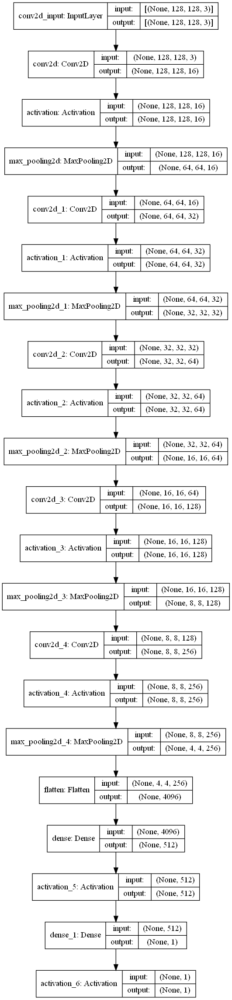

In [7]:
model = Sequential()

# Initial Conv Layer
model.add(Conv2D(16, (3, 3), padding="same", input_shape=(128, 128, 3)))
model.add(Activation("relu"))
model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

# Second Conv Layer
model.add(Conv2D(32, (3, 3), padding="same"))
model.add(Activation("relu"))
model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

# Third Conv Layer
model.add(Conv2D(64, (3, 3), padding="same"))
model.add(Activation("relu"))
model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

# Fourth Conv Layer
model.add(Conv2D(128, (3, 3), padding="same"))
model.add(Activation("relu"))
model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

# Fifth Conv Layer
model.add(Conv2D(256, (3, 3), padding="same"))
model.add(Activation("relu"))
model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

# Flatten and Dense Layers
model.add(Flatten())
model.add(Dense(512))  # Reduced to 512 to match the parameter count
model.add(Activation("relu"))

# Output Layer
model.add(Dense(1))
model.add(Activation("sigmoid"))

# Show the model summary
model.summary()

# Plot the model
plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True)

### Compilación y entrenamiento

In [8]:
# Configuración del optimizador
opt = Adam(learning_rate=0.0001, decay=1e-6)
model.compile(loss="binary_crossentropy", optimizer=opt, metrics=["accuracy"])

# Configuración de early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Entrenamiento con early stopping
H = model.fit(trainX, trainY, validation_data=(testX, testY), 
              epochs=50, batch_size=64, callbacks=[early_stopping])

Epoch 1/50
375/375 [==============================] - 152s 404ms/step - loss: 0.1397 - accuracy: 0.9473 - val_loss: 0.0446 - val_accuracy: 0.9869
Epoch 2/50
375/375 [==============================] - 144s 385ms/step - loss: 0.0457 - accuracy: 0.9865 - val_loss: 0.0414 - val_accuracy: 0.9866
Epoch 3/50
375/375 [==============================] - 148s 395ms/step - loss: 0.0330 - accuracy: 0.9894 - val_loss: 0.0291 - val_accuracy: 0.9908
Epoch 4/50
375/375 [==============================] - 149s 396ms/step - loss: 0.0222 - accuracy: 0.9923 - val_loss: 0.0156 - val_accuracy: 0.9941
Epoch 5/50
375/375 [==============================] - 151s 403ms/step - loss: 0.0170 - accuracy: 0.9943 - val_loss: 0.0140 - val_accuracy: 0.9950
Epoch 6/50
375/375 [==============================] - 142s 380ms/step - loss: 0.0143 - accuracy: 0.9954 - val_loss: 0.0263 - val_accuracy: 0.9901
Epoch 7/50
375/375 [==============================] - 139s 372ms/step - loss: 0.0099 - accuracy: 0.9971 - val_loss: 0.0118 -

### Guardar el modelo completo (arquitectura, pesos y configuración)

In [9]:
model.save('CrackDetectorV1.h5')

### Predicciones y reporte

In [15]:
# Obtener las predicciones de probabilidad
predictions_prob = model.predict(valX)

# Convertir las probabilidades en clases binarias (0 o 1)
predictions = (predictions_prob > 0.5).astype("int32")

# Asegurarse de que las etiquetas verdaderas también sean binarias
valY_binary = valY.astype("int32")

# Imprimir el reporte de clasificación
print(classification_report(valY_binary, predictions, target_names=['Sin Grieta', 'Con Grieta']))

              precision    recall  f1-score   support

  Sin Grieta       1.00      1.00      1.00      3955
  Con Grieta       1.00      1.00      1.00      4045

    accuracy                           1.00      8000
   macro avg       1.00      1.00      1.00      8000
weighted avg       1.00      1.00      1.00      8000



### Guardar la historia en un archivo

In [11]:
with open('historia_entrenamientoV1.pkl', 'wb') as f:
    pickle.dump(H.history, f)

### Graficar y guardar la pérdida

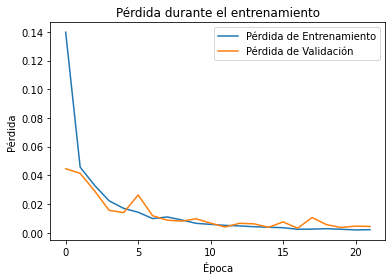

In [12]:
plt.plot(H.history['loss'], label='Pérdida de Entrenamiento')
plt.plot(H.history['val_loss'], label='Pérdida de Validación')
plt.title('Pérdida durante el entrenamiento')
plt.xlabel('Época')
plt.ylabel('Pérdida')
plt.legend()
plt.savefig('grafica_perdidaV1.png')



### Graficar y guardar la precisión

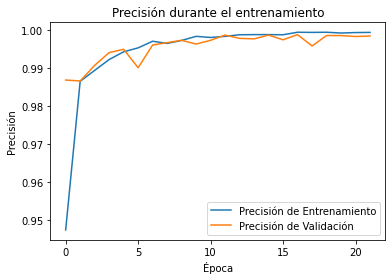

In [13]:
plt.plot(H.history['accuracy'], label='Precisión de Entrenamiento')
plt.plot(H.history['val_accuracy'], label='Precisión de Validación')
plt.title('Precisión durante el entrenamiento')
plt.xlabel('Época')
plt.ylabel('Precisión')
plt.legend()
plt.savefig('grafica_precisionV1.png')

### Bucle para mostrar 400 imágenes aleatorias con sus predicciones

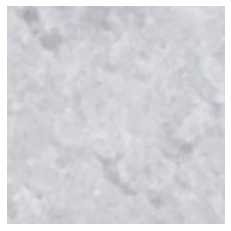

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


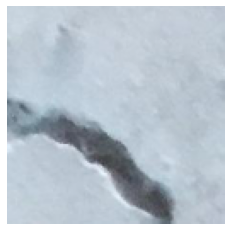

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


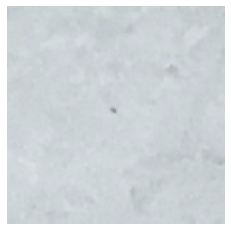

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


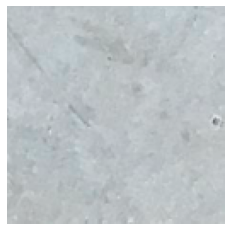

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


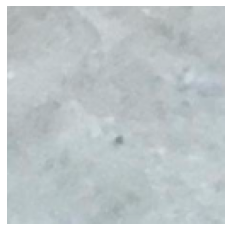

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


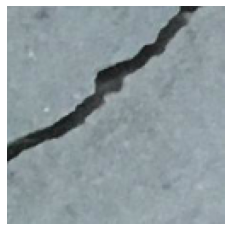

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


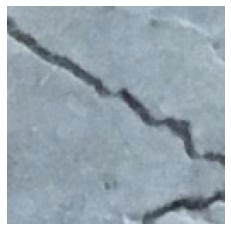

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


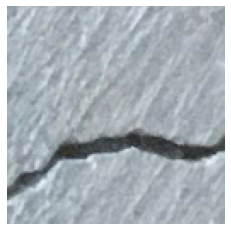

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


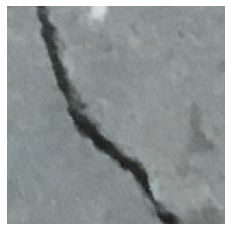

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


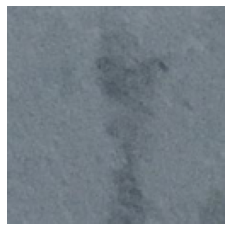

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.71%


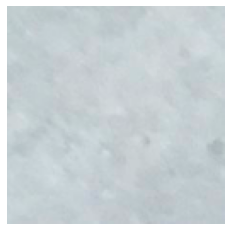

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


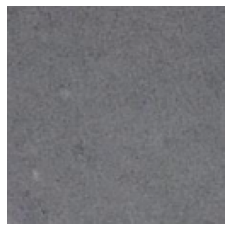

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


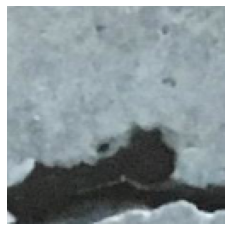

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


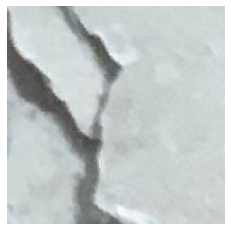

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


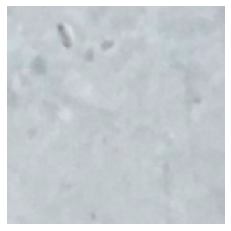

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


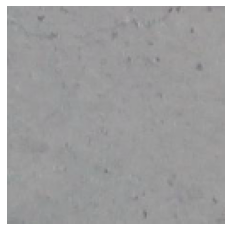

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.98%


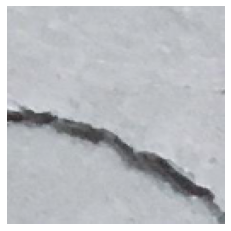

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


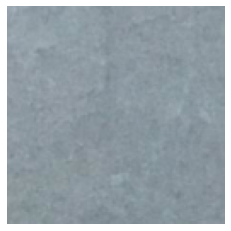

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


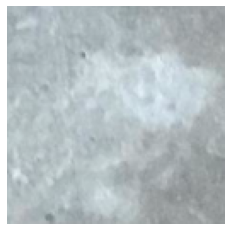

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


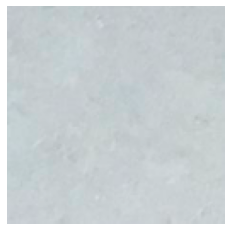

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


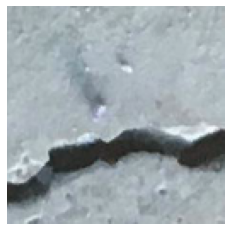

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


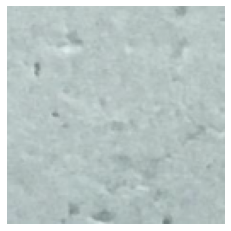

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


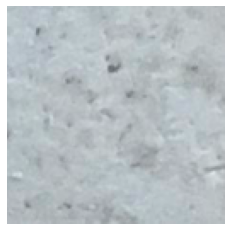

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


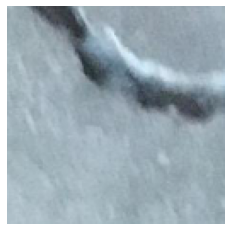

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


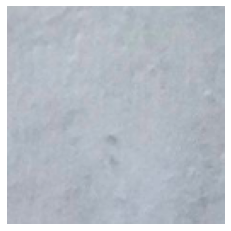

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


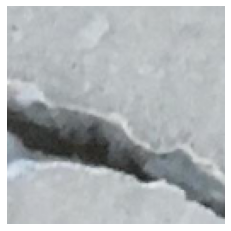

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


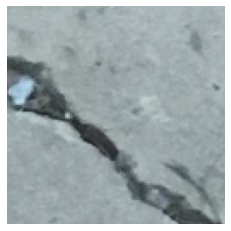

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


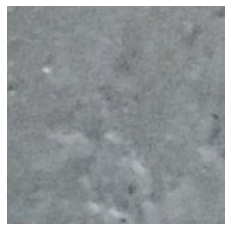

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.97%


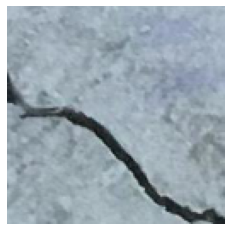

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


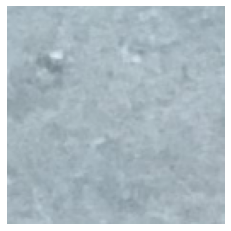

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


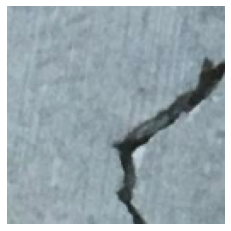

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


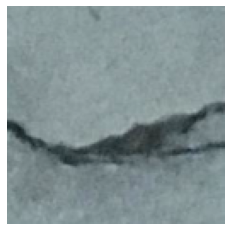

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


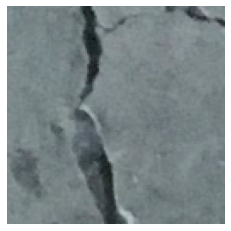

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


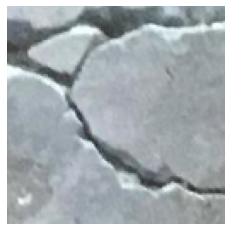

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


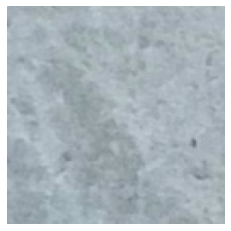

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


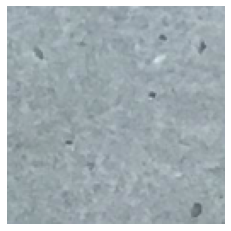

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.98%


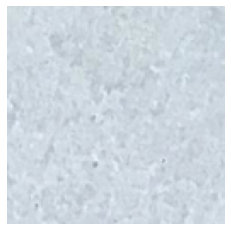

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


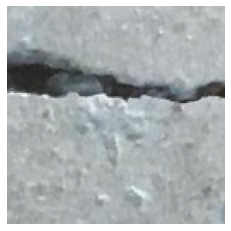

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


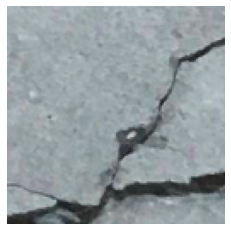

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


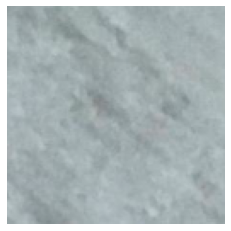

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


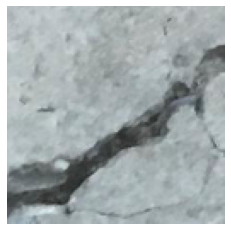

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


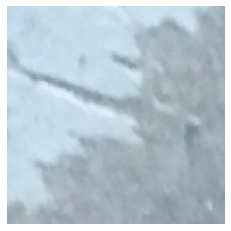

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 89.80%


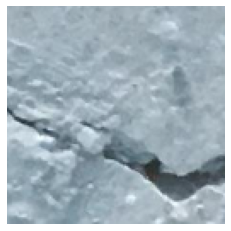

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


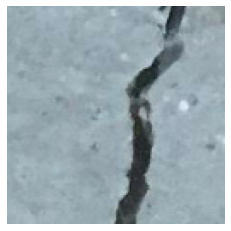

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


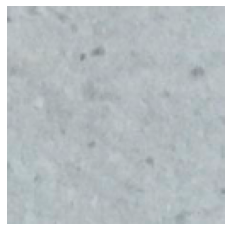

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


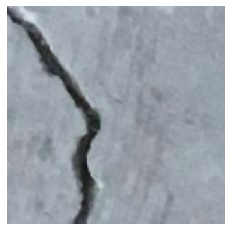

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


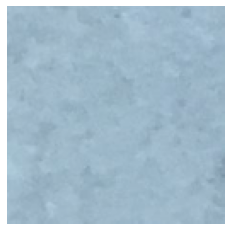

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


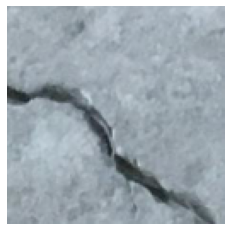

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


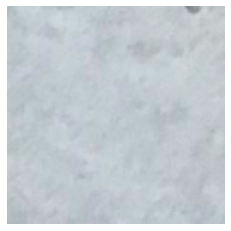

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


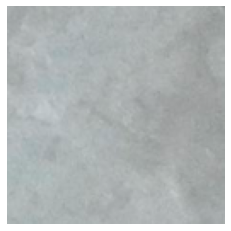

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


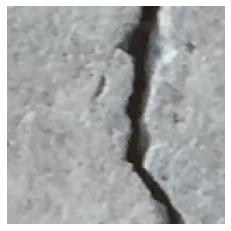

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


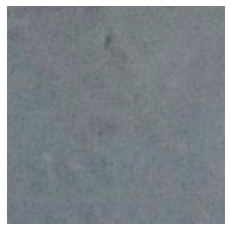

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.98%


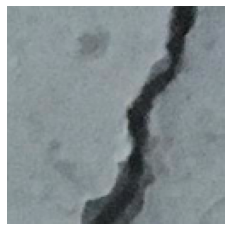

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


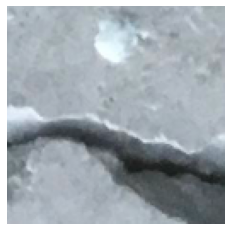

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


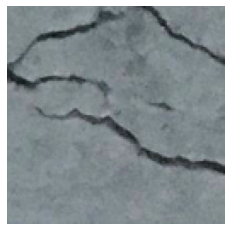

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


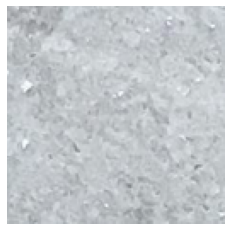

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


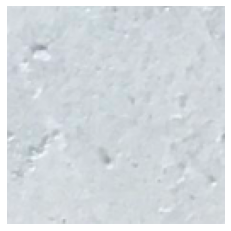

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


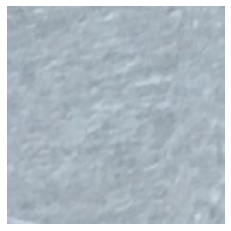

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


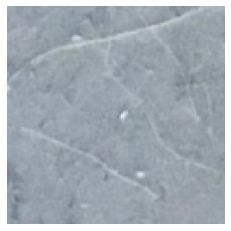

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


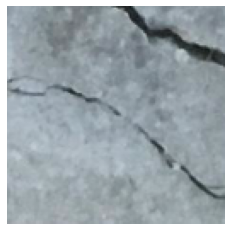

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


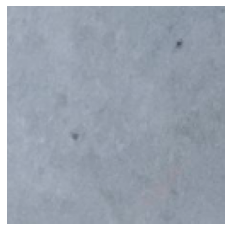

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


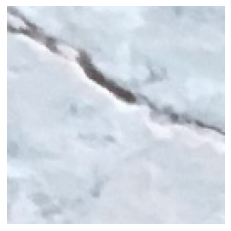

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.09%


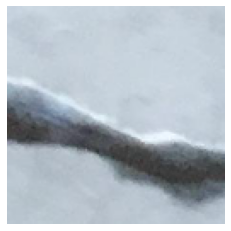

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


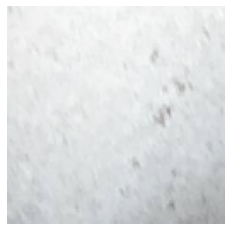

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


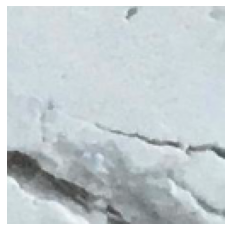

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


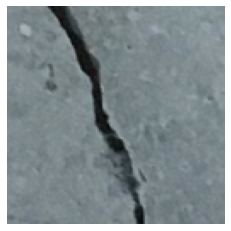

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


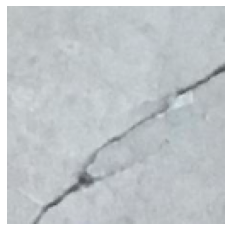

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


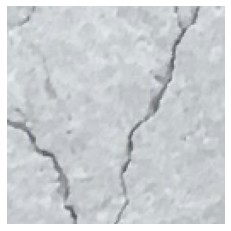

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


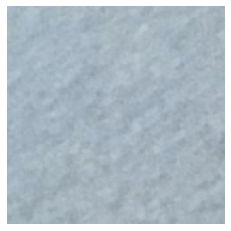

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


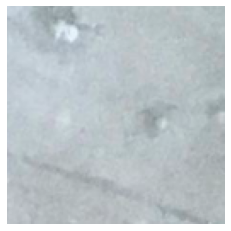

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


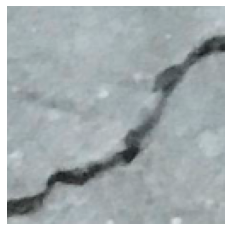

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


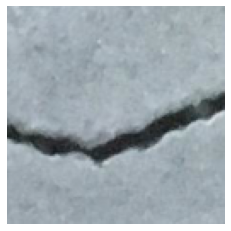

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


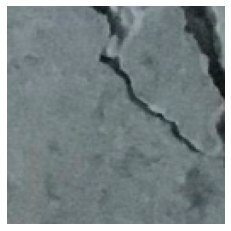

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


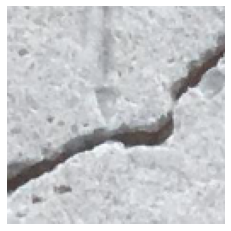

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


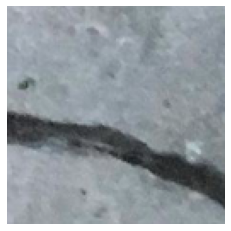

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


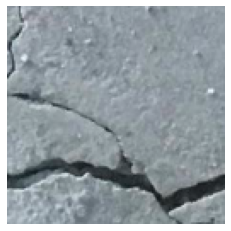

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


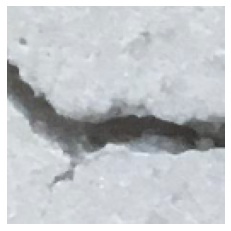

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


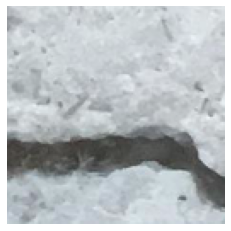

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


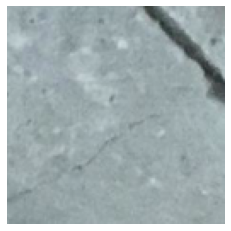

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.33%


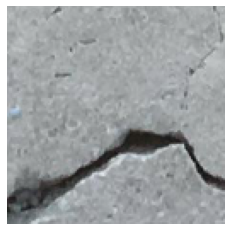

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


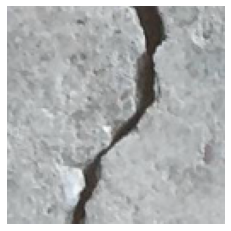

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


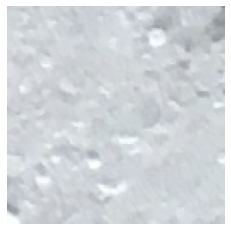

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


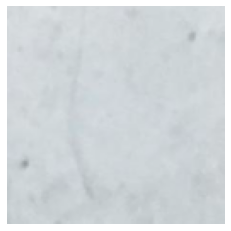

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


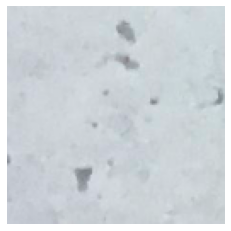

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.95%


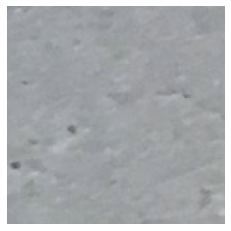

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.98%


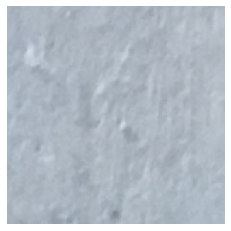

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


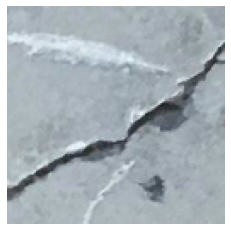

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


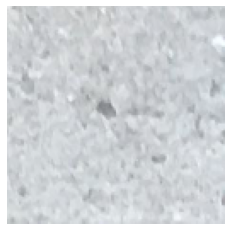

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.95%


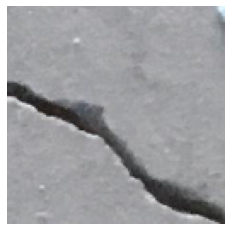

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


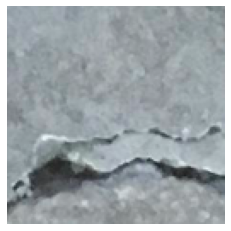

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


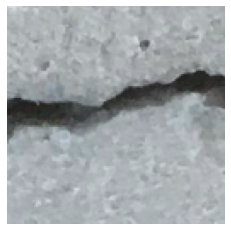

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


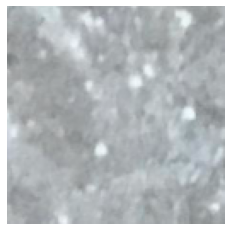

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


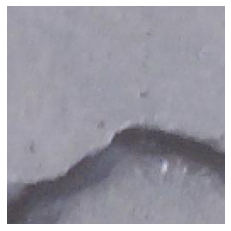

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


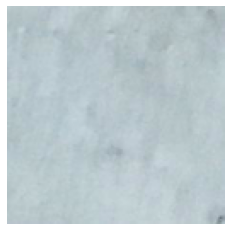

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


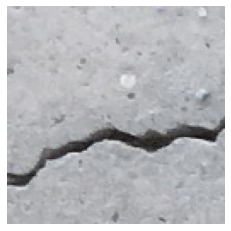

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


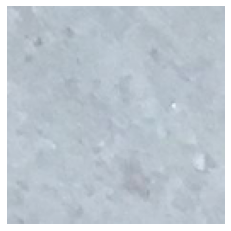

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


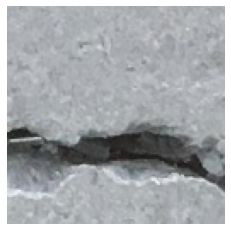

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


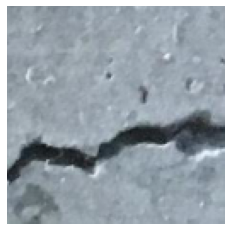

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


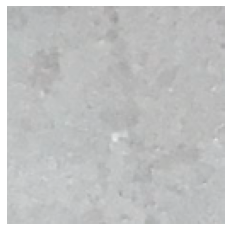

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


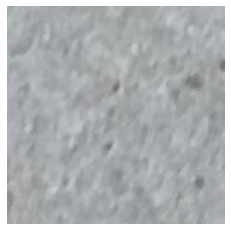

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.97%


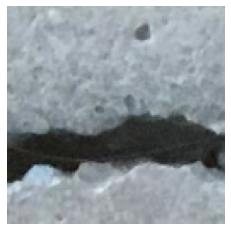

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


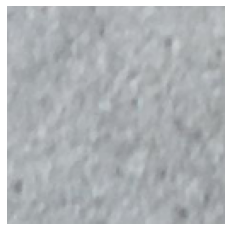

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


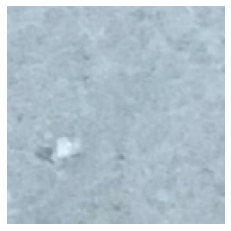

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


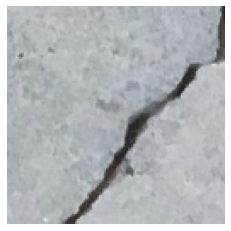

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


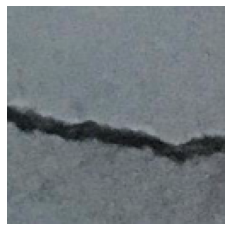

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


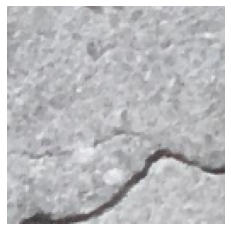

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.25%


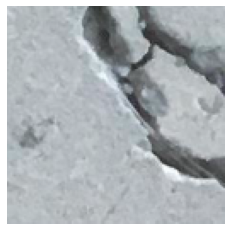

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


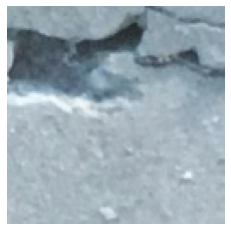

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


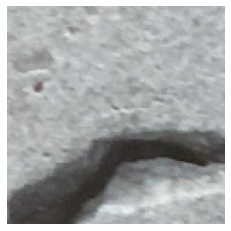

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


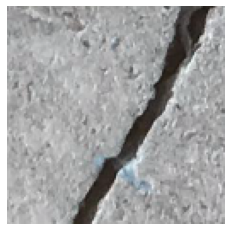

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


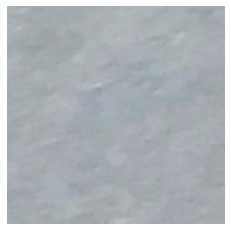

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


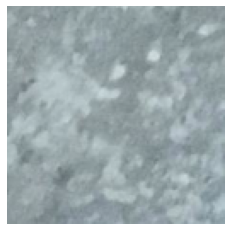

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


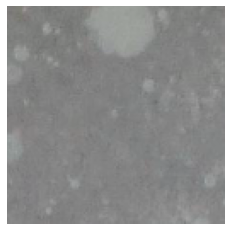

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


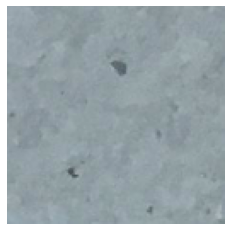

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.98%


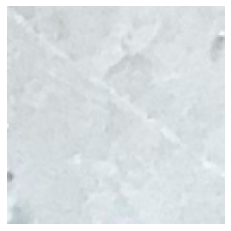

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


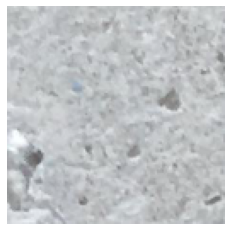

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.80%


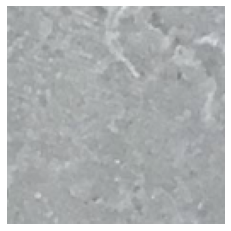

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


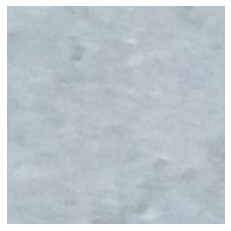

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


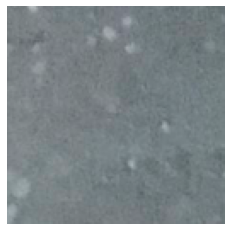

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.97%


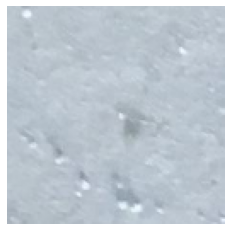

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


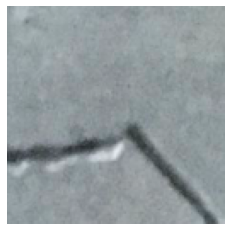

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


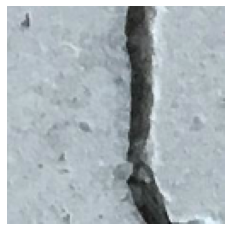

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


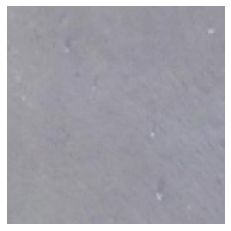

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


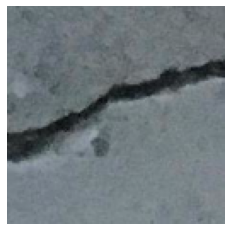

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


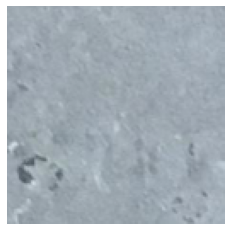

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


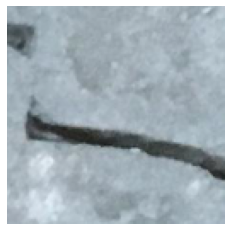

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


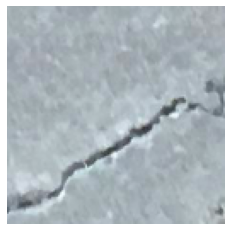

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


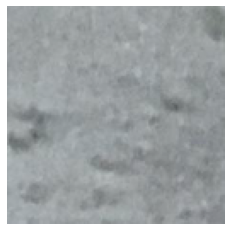

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.12%


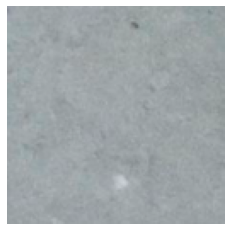

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


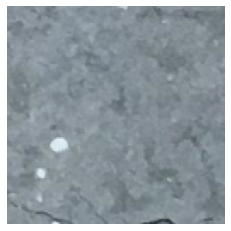

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


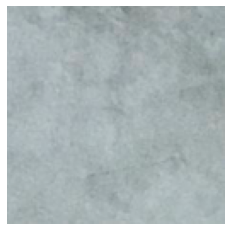

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


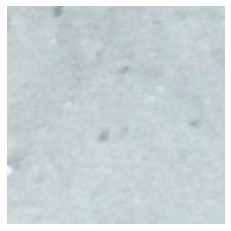

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


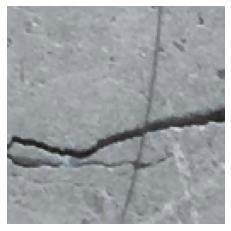

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


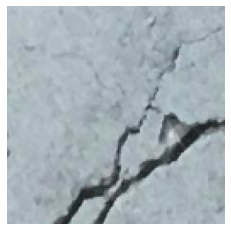

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


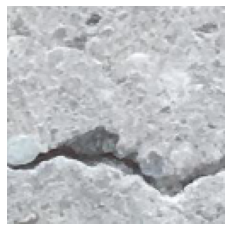

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


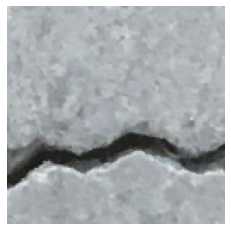

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


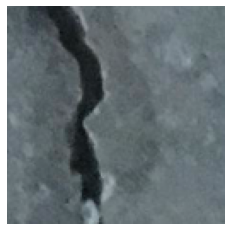

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


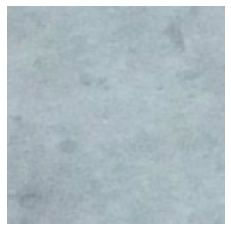

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


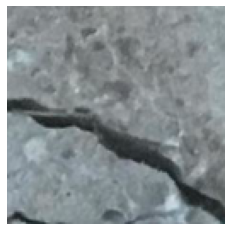

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


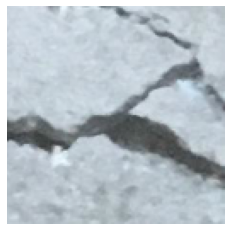

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


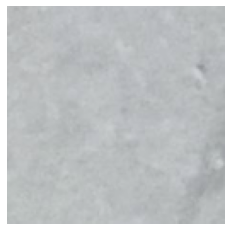

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


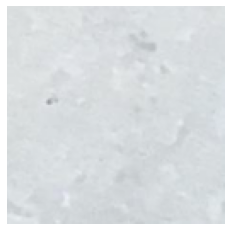

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


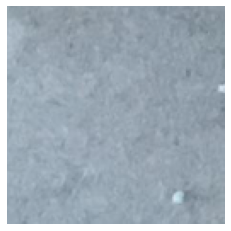

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


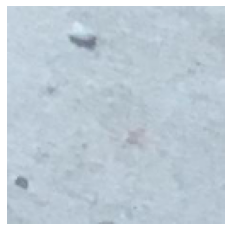

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.92%


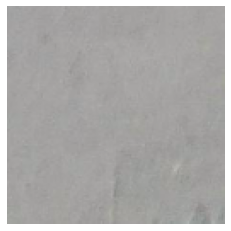

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.98%


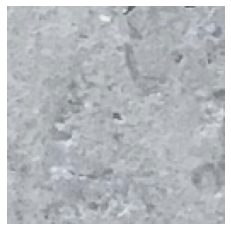

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.98%


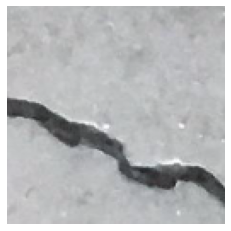

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


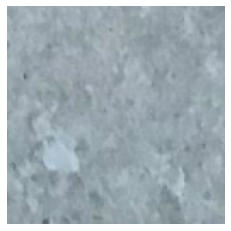

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


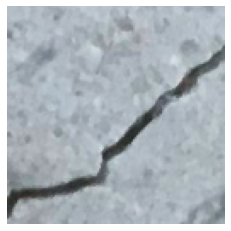

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


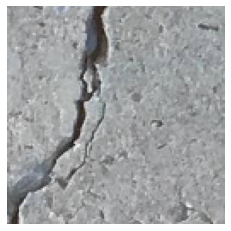

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


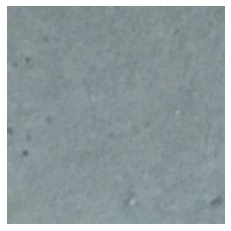

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


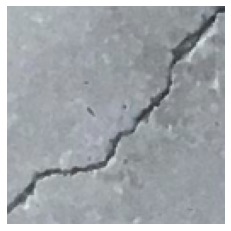

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


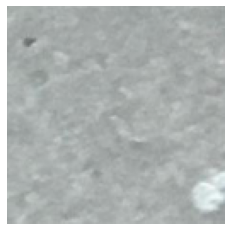

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


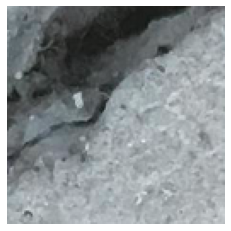

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


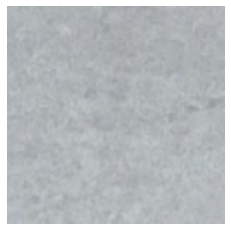

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


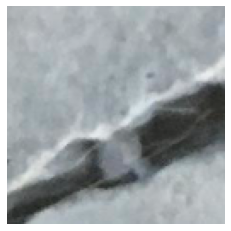

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


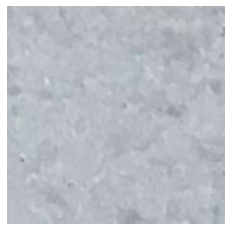

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


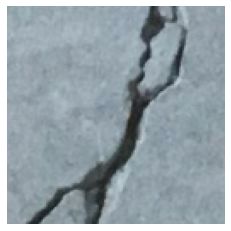

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


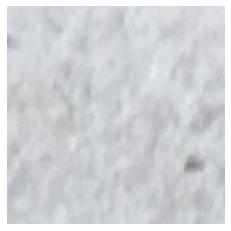

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


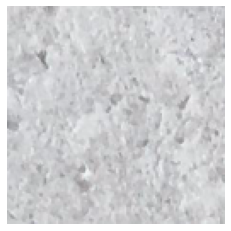

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


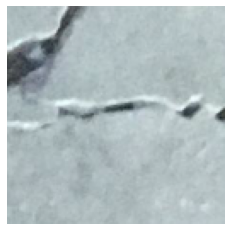

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


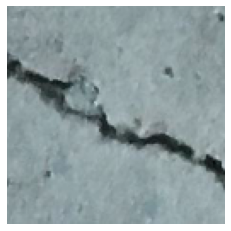

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


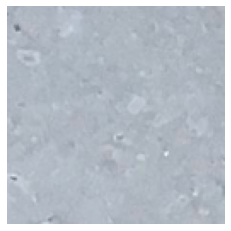

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


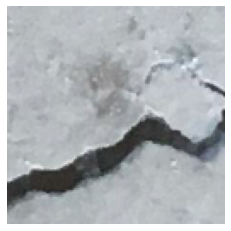

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


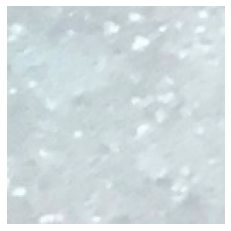

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


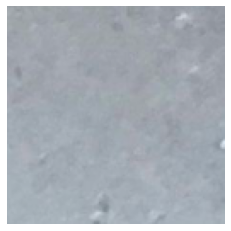

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


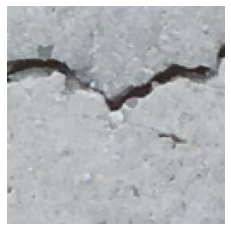

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


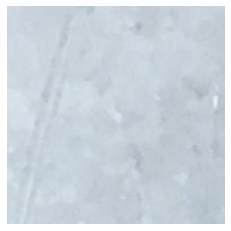

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


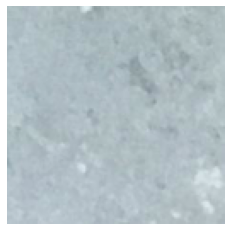

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


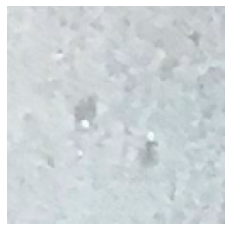

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


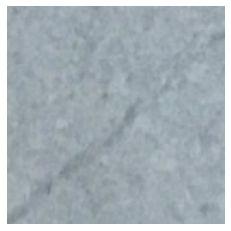

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


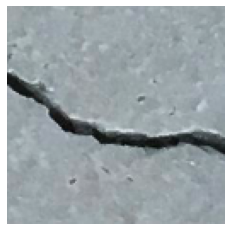

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


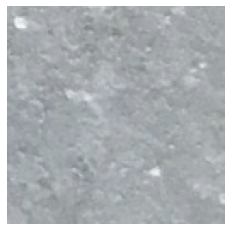

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


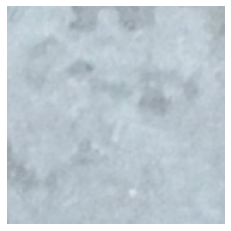

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


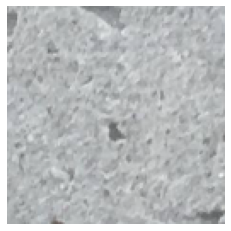

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.91%


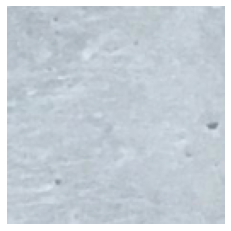

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


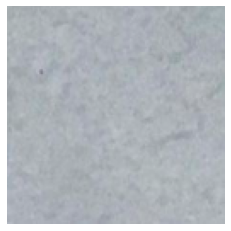

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


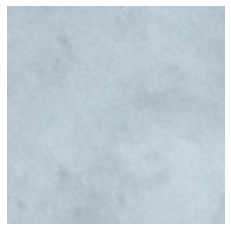

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


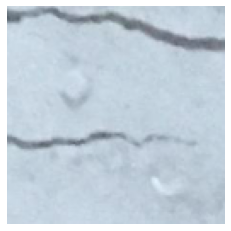

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


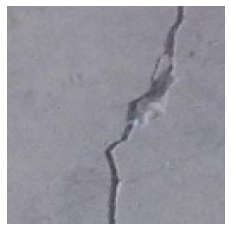

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


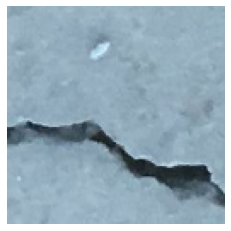

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


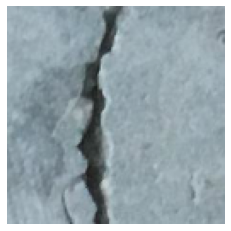

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


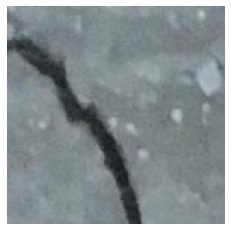

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


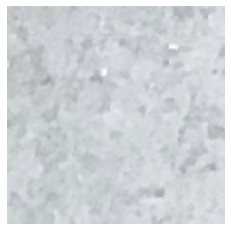

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


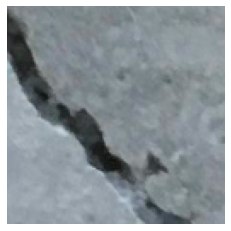

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


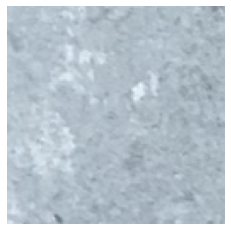

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


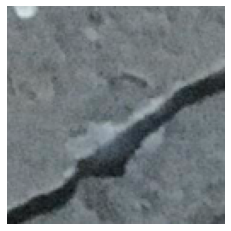

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


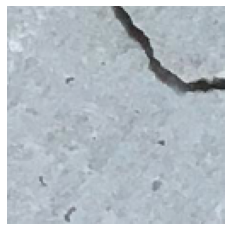

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


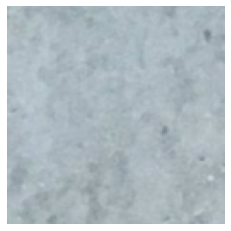

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


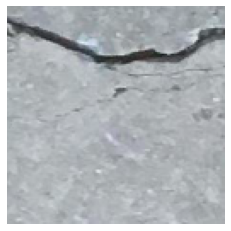

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


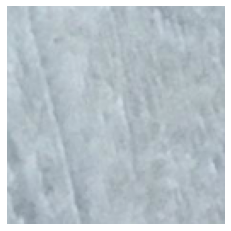

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


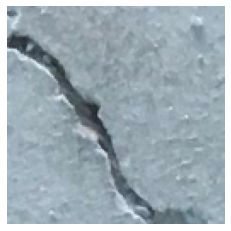

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


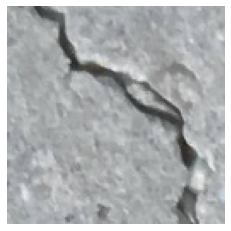

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


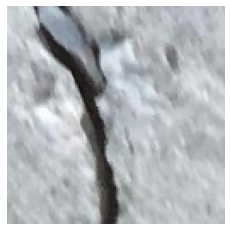

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


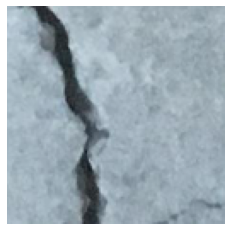

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


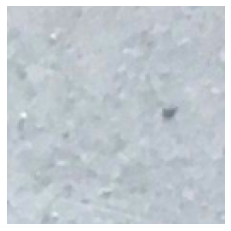

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


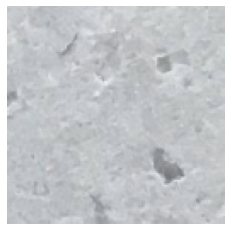

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


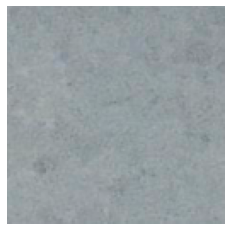

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


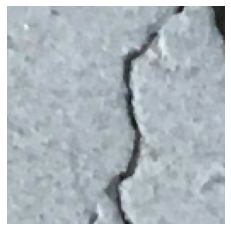

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


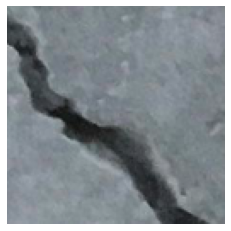

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


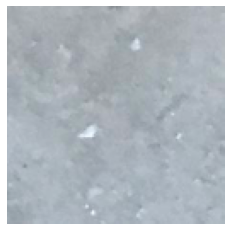

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


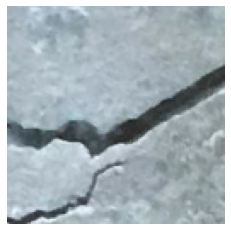

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


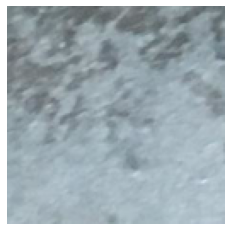

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.69%


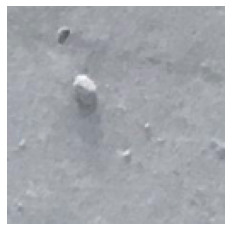

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.13%


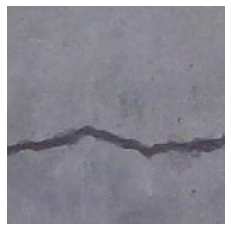

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


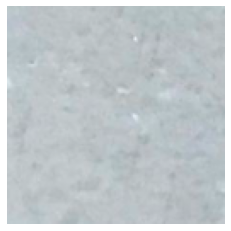

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


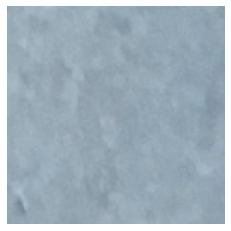

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


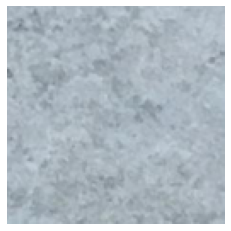

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


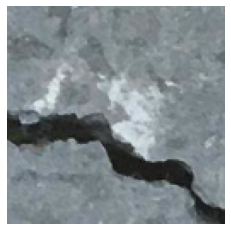

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


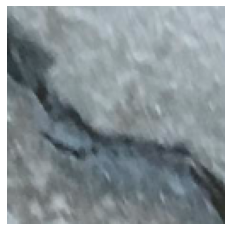

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


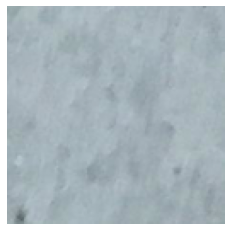

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


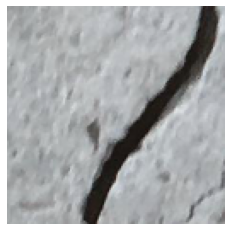

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


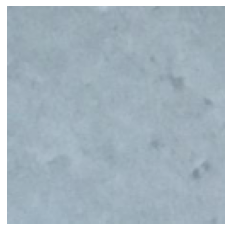

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


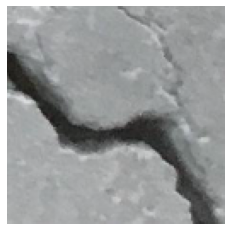

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


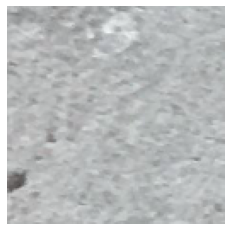

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


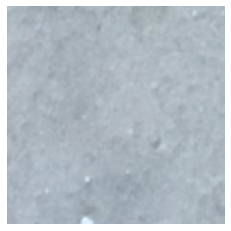

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


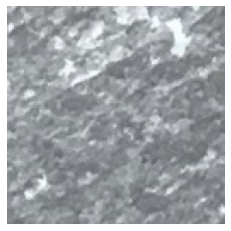

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


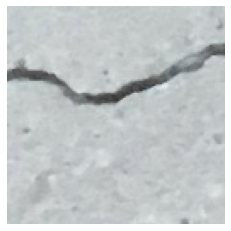

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


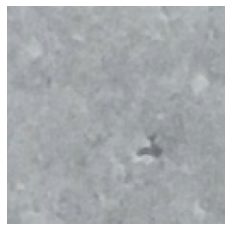

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.98%


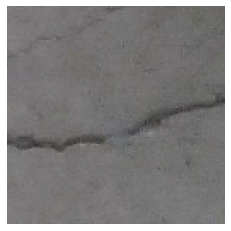

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.01%


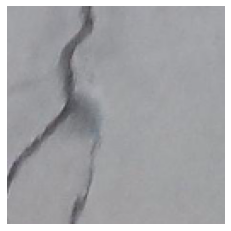

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.01%


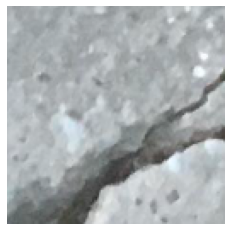

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


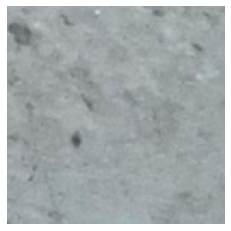

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.98%


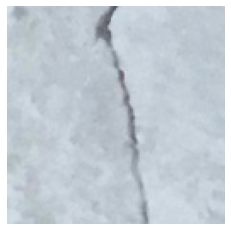

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


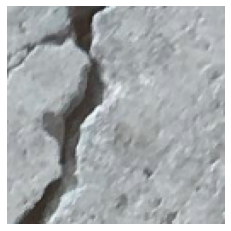

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


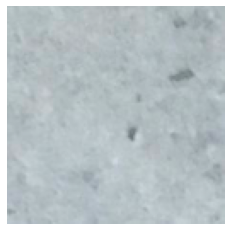

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.97%


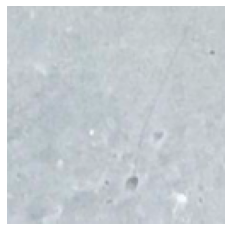

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


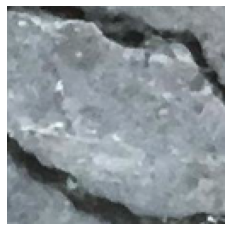

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


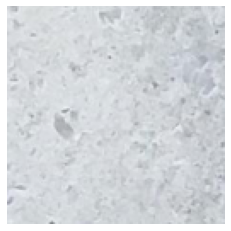

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


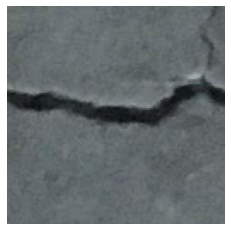

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


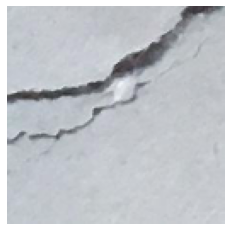

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


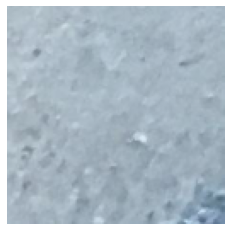

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


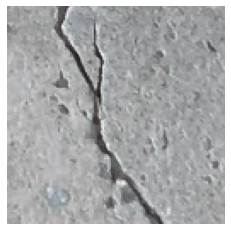

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


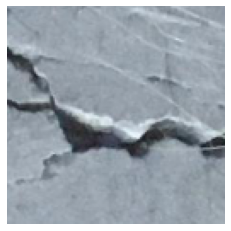

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


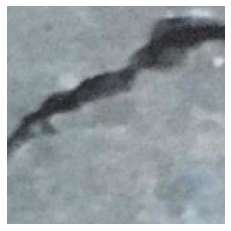

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


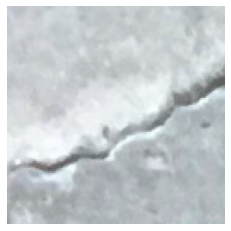

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


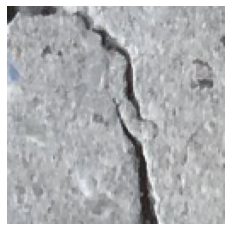

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


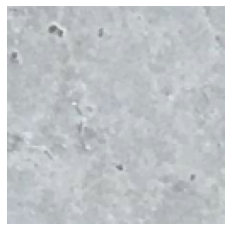

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.98%


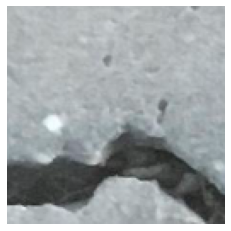

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


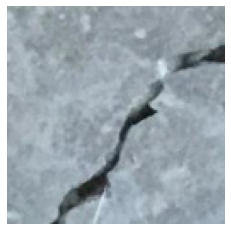

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


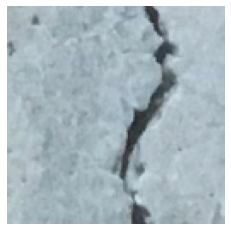

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


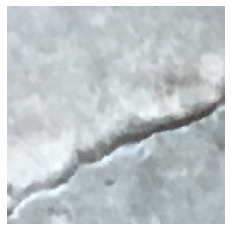

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


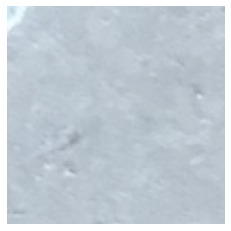

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


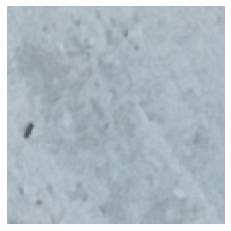

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.98%


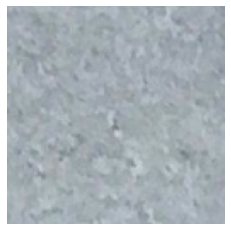

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


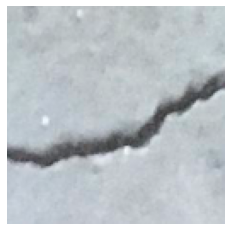

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


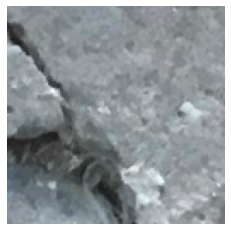

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


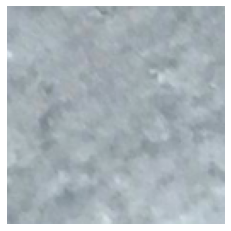

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


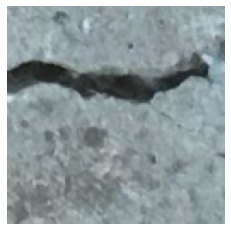

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


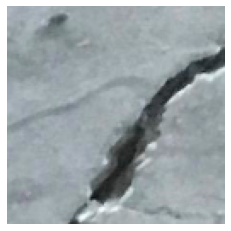

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


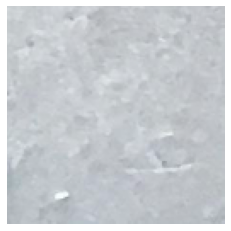

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


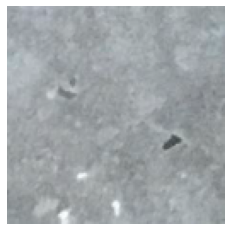

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.76%


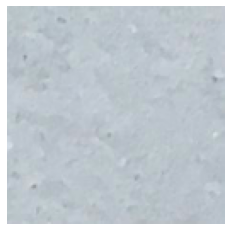

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


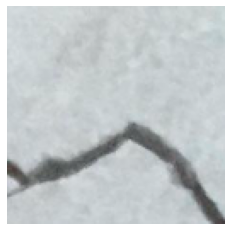

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


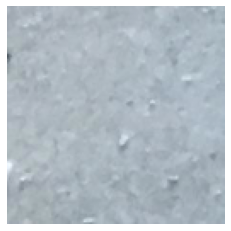

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


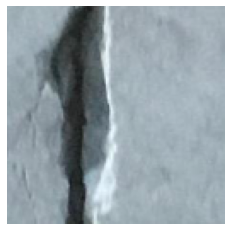

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


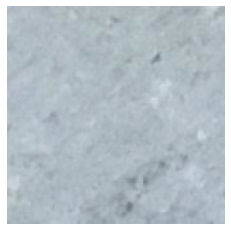

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


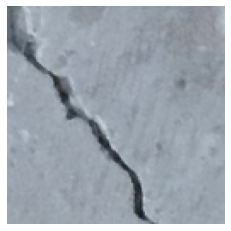

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


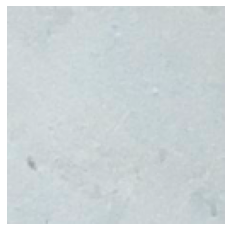

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


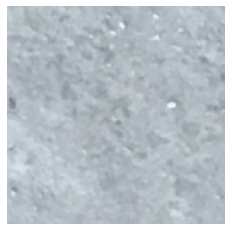

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


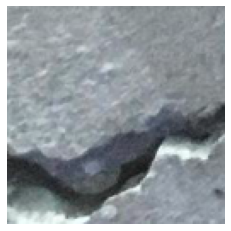

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


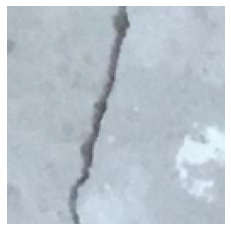

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


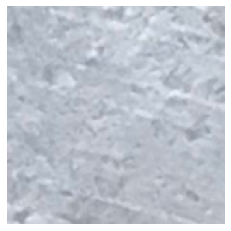

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


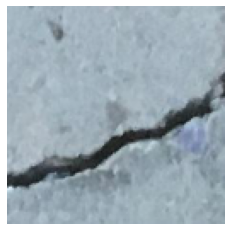

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


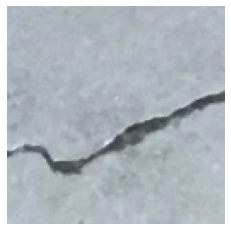

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


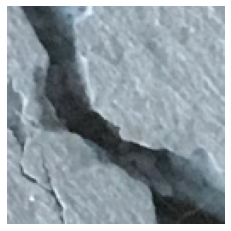

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


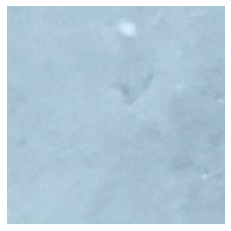

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


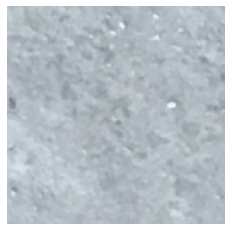

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


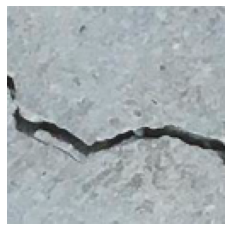

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


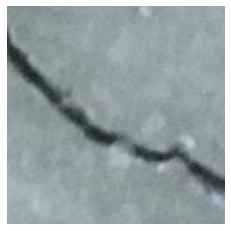

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


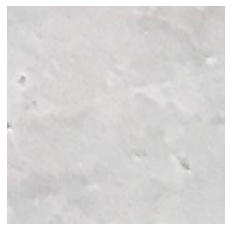

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


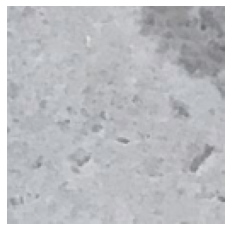

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.98%


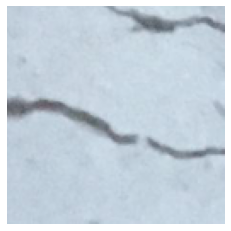

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


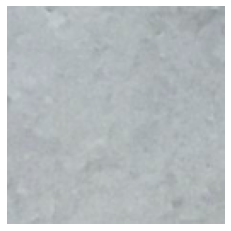

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


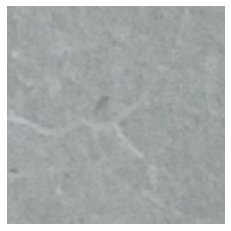

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


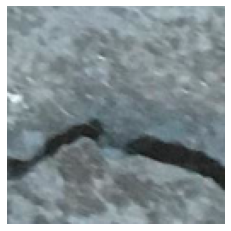

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


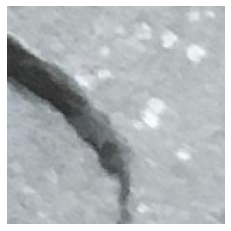

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


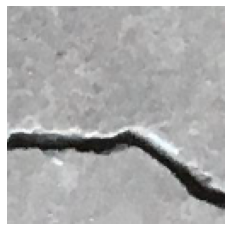

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


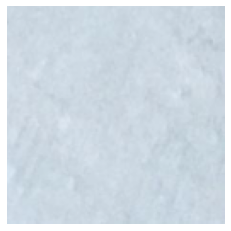

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


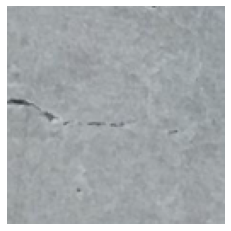

Ground truth class: Con_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 91.87%
Wrong prediction#####################################################


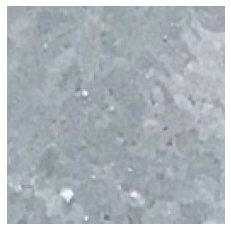

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


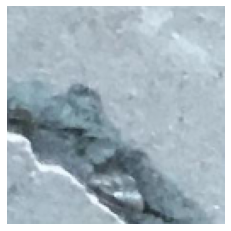

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


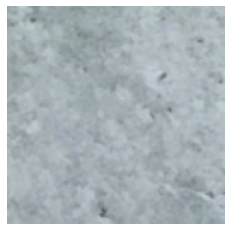

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


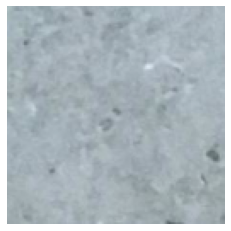

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


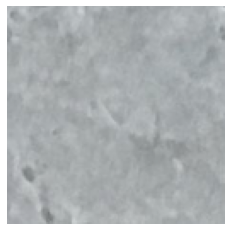

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


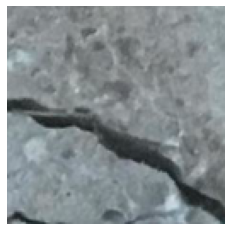

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


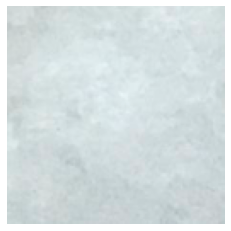

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


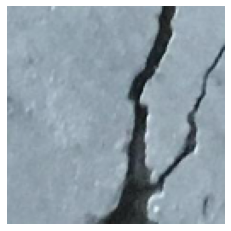

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


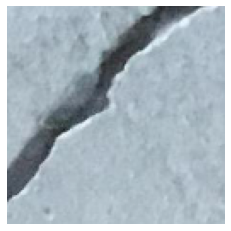

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


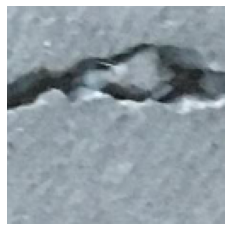

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


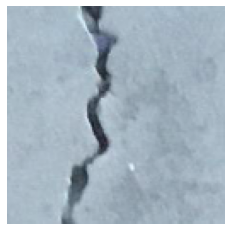

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


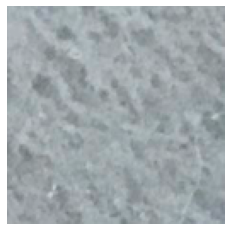

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


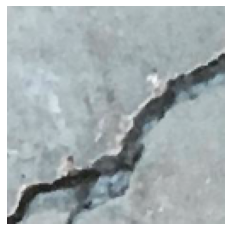

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


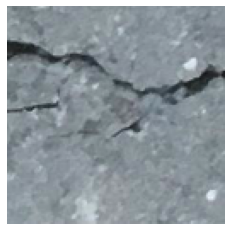

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


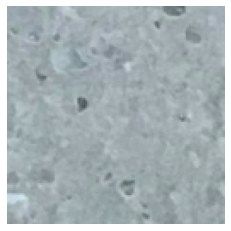

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


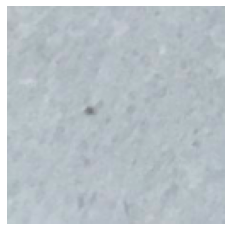

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


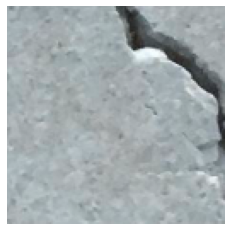

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


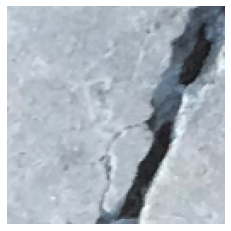

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


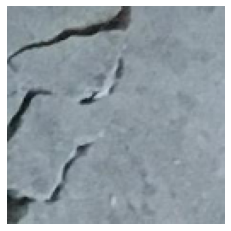

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


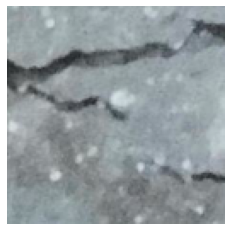

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


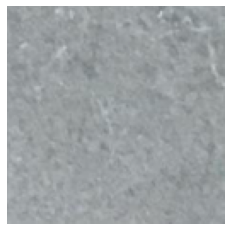

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


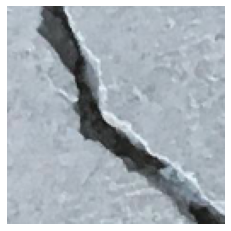

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


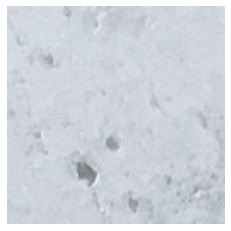

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


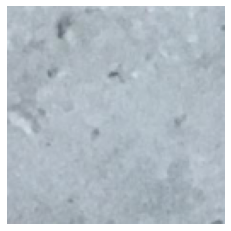

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


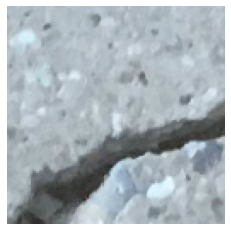

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


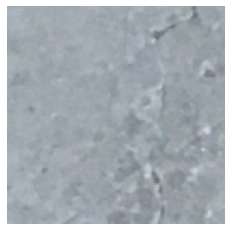

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


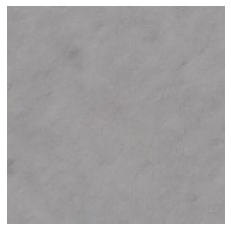

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.97%


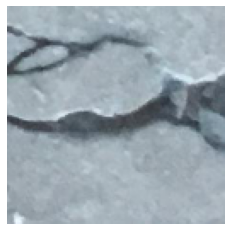

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


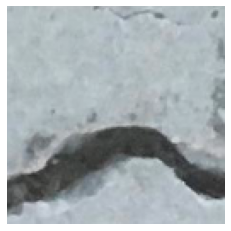

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


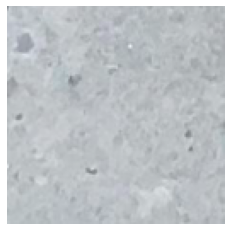

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


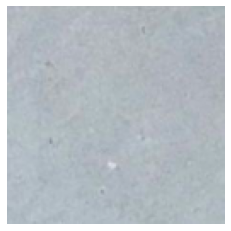

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


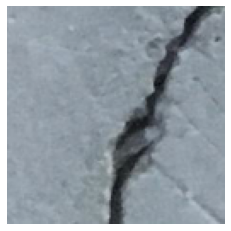

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


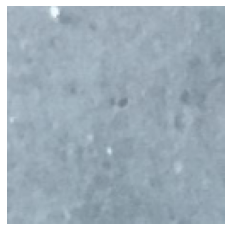

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.98%


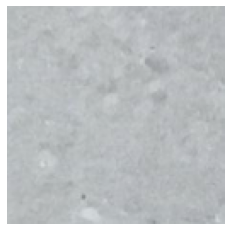

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


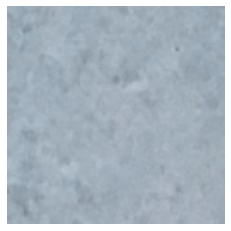

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


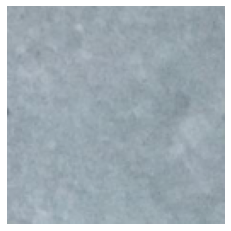

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


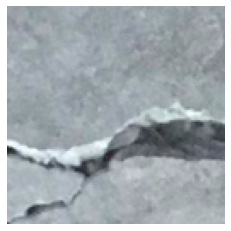

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


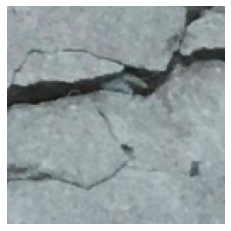

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


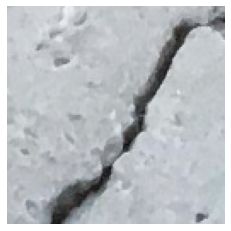

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


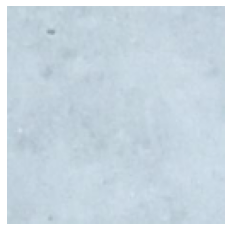

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


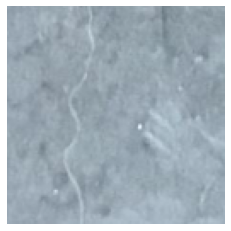

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


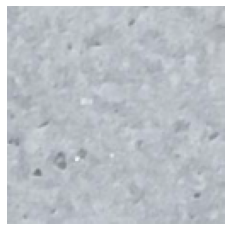

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


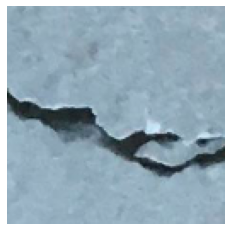

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


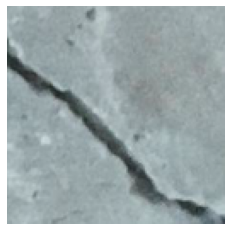

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


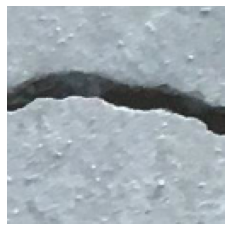

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


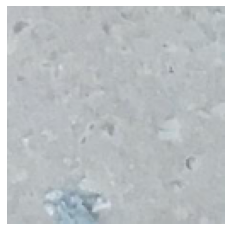

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


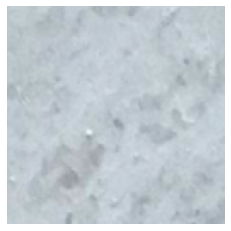

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


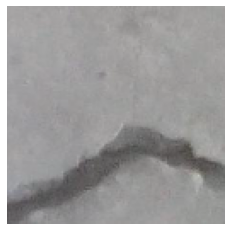

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.01%


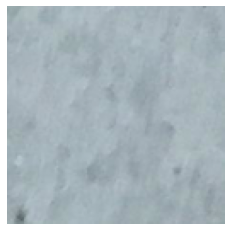

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


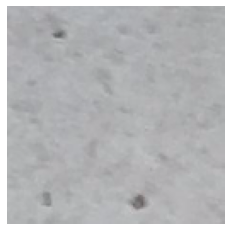

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.93%


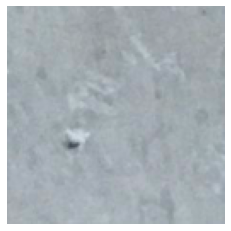

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.96%


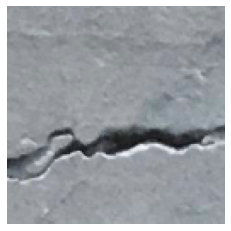

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


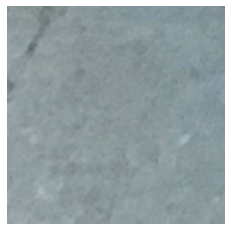

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


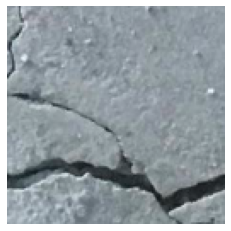

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


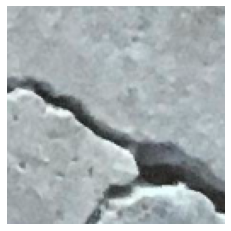

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


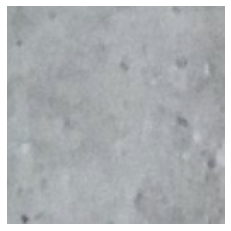

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


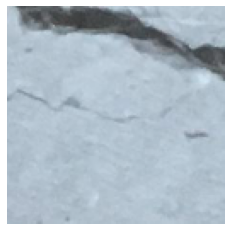

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


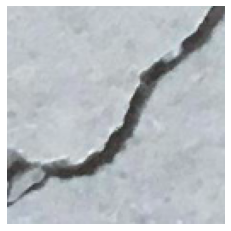

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


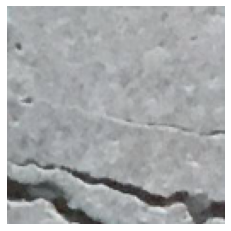

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


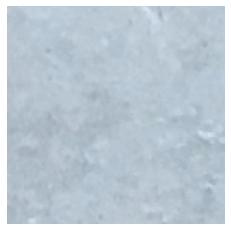

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


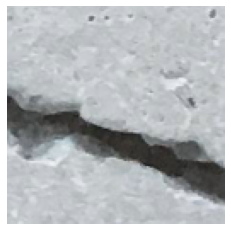

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


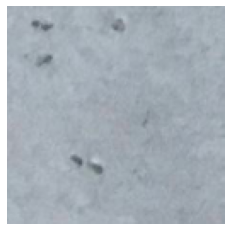

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.95%


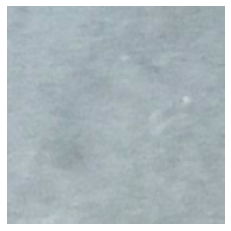

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


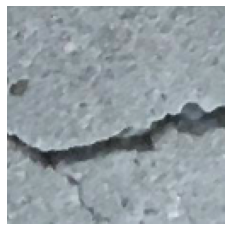

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


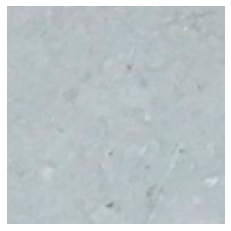

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


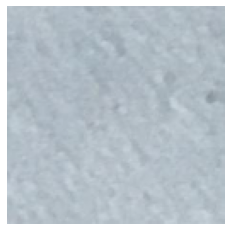

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


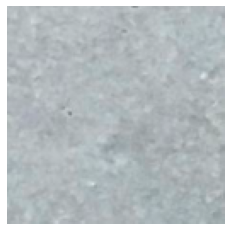

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


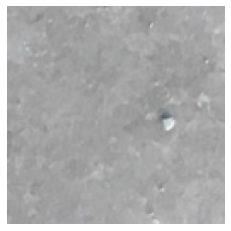

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.86%


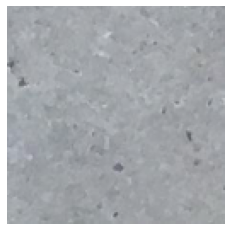

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.98%


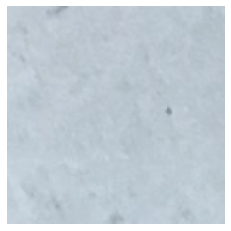

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


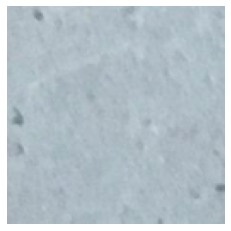

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


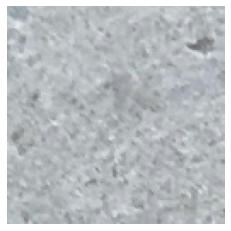

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


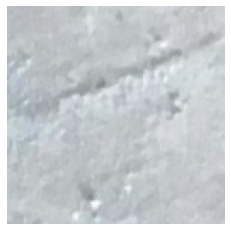

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.89%


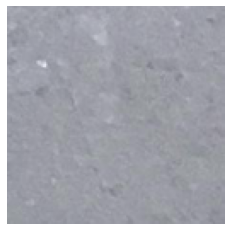

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


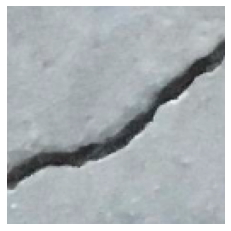

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


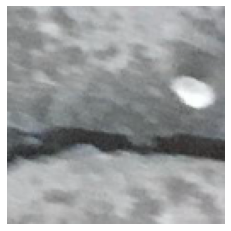

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


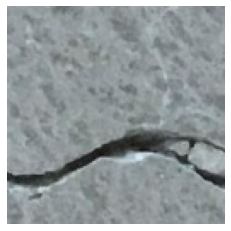

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


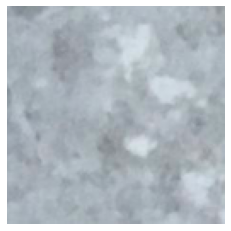

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


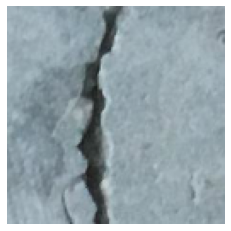

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


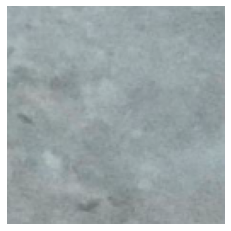

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


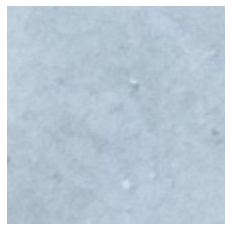

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


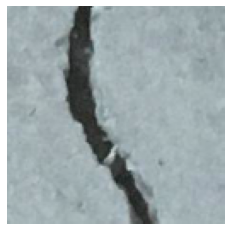

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


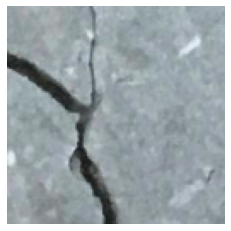

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


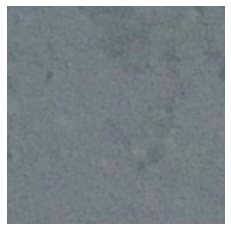

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


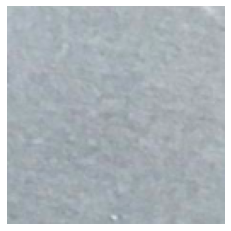

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


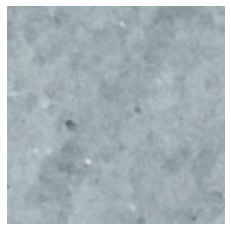

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


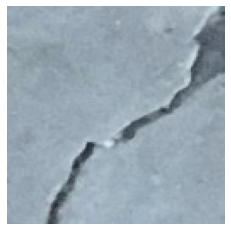

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


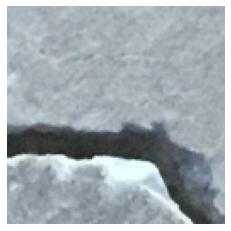

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


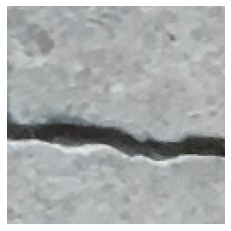

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


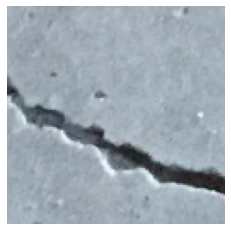

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


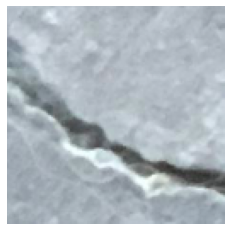

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


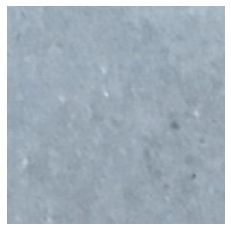

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


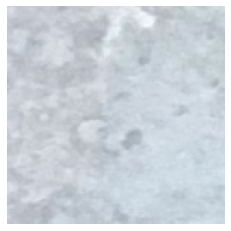

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


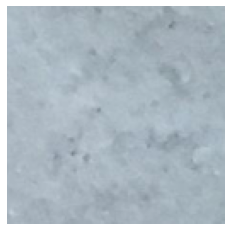

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


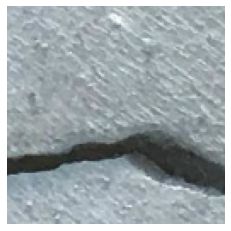

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


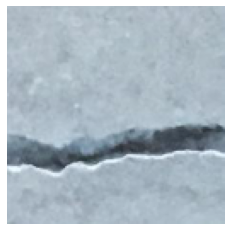

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


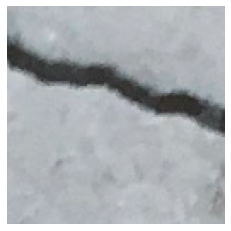

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


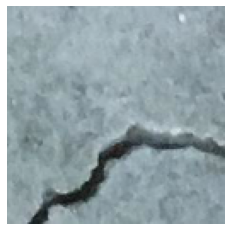

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


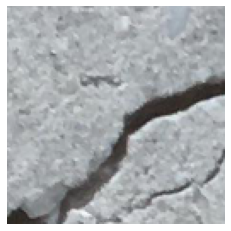

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


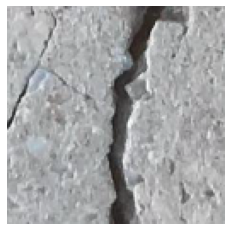

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


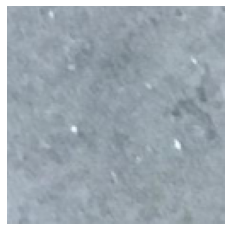

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.97%


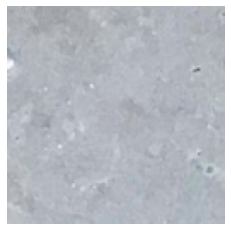

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


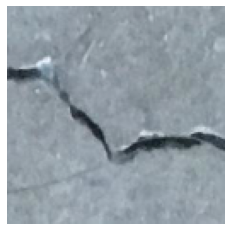

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


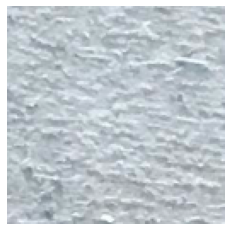

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


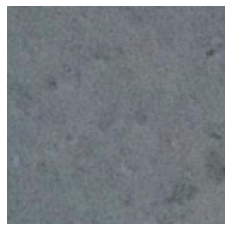

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


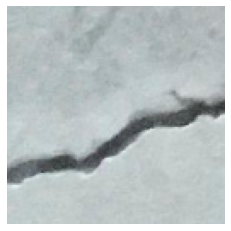

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


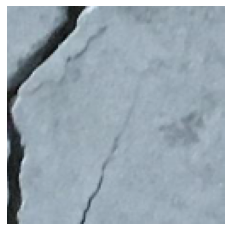

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


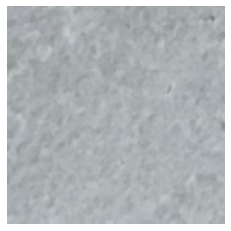

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


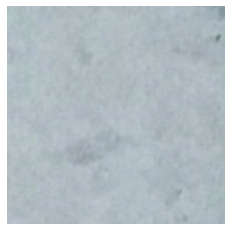

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


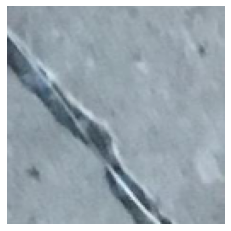

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


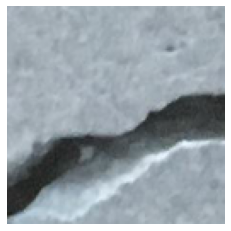

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


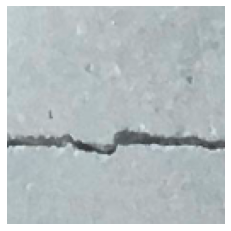

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


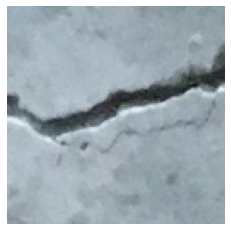

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


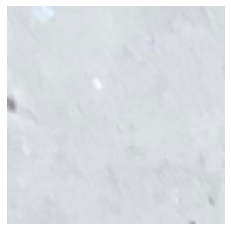

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


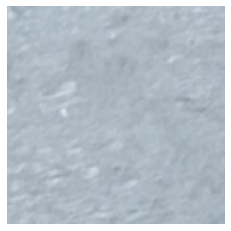

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


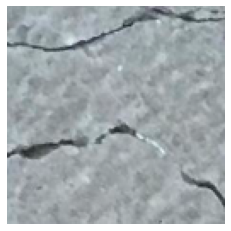

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.00%


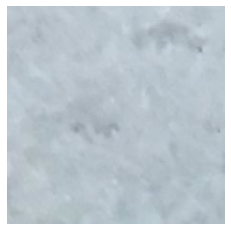

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


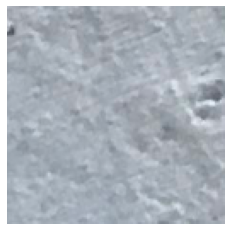

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 99.99%


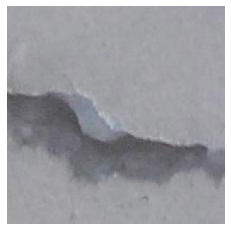

Ground truth class: Con_Grietas
Predicted class: Con_Grietas
Prediction confidence: 0.01%


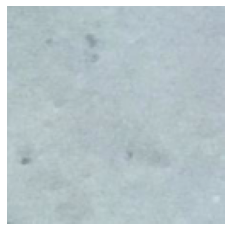

Ground truth class: Sin_Grietas
Predicted class: Sin_Grietas
Prediction confidence: 100.00%


In [16]:
# Obtener las predicciones y las probabilidades
predictions_prob = model.predict(valX)
predicted_classes = (predictions_prob > 0.5).astype("int32")

for _ in range(400):
    rand_pos = random.randint(0, len(valX) - 1)
    rand_img = valX[rand_pos]
    
    # Mostrar la imagen con matplotlib
    plt.imshow(rand_img)  
    plt.axis('off')  # Ocultar los ejes
    plt.show()
    
    # Mostrar la clase real y predicha
    ground_truth_class = lb.classes_[valY[rand_pos]]
    predicted_class = lb.classes_[predicted_classes[rand_pos][0]]
    prediction_confidence = predictions_prob[rand_pos][0] * 100  # Convertir a porcentaje
    
    print(f'Ground truth class: {ground_truth_class}')
    print(f'Predicted class: {predicted_class}')
    print(f'Prediction confidence: {prediction_confidence:.2f}%')
    
    # Verificar si la predicción fue incorrecta
    if valY[rand_pos] != predicted_classes[rand_pos][0]:
        print('Wrong prediction#####################################################')